<a href="https://colab.research.google.com/github/CasonHarrison/casonharrison.github.io/blob/emilymizuki-patch-1/ML_Project_Team25.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!sudo apt install -y fluidsynth
!pip install pyfluidsynth --upgrade
!pip install mido
!pip install pretty_midi
!pip install matplotlib
!pip install midi2audio

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  fluid-soundfont-gm libevdev2 libfluidsynth3 libgudev-1.0-0 libinput-bin
  libinput10 libinstpatch-1.0-2 libmd4c0 libmtdev1 libqt5core5a libqt5dbus5
  libqt5gui5 libqt5network5 libqt5svg5 libqt5widgets5 libwacom-bin
  libwacom-common libwacom9 libxcb-icccm4 libxcb-image0 libxcb-keysyms1
  libxcb-render-util0 libxcb-util1 libxcb-xinerama0 libxcb-xinput0 libxcb-xkb1
  libxkbcommon-x11-0 qsynth qt5-gtk-platformtheme qttranslations5-l10n
  timgm6mb-soundfont
Suggested packages:
  fluid-soundfont-gs qt5-image-formats-plugins qtwayland5 jackd
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libevdev2 libfluidsynth3 libgudev-1.0-0
  libinput-bin libinput10 libinstpatch-1.0-2 libmd4c0 libmtdev1 libqt5core5a
  libqt5dbus5 libqt5gui5 libqt5network5 libqt5svg5 libqt5widgets5 libwacom-bin
  libwacom-common libwacom9 libx

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: ignored

In [ ]:
import collections
import glob
import mido
import pretty_midi
import fluidsynth
import tensorflow as tf
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from IPython import display
from IPython.display import Audio
from midi2audio import FluidSynth

# Data pre-processing

Our training dataset contains short MIDI files that are not soundtracks(i.e. sound effects). We clean our dataset by grabbing all MIDI files that are >= 30 seconds in length under the assumption that files with such length are soundtracks.

In [ ]:
raw_train_data = glob.glob(str('/content/drive/MyDrive/ML Bing Bing/nesmdb_midi/train**/*.mid*'))
train_data = []
for i in range(len(raw_train_data)):
  if mido.MidiFile(raw_train_data[i]).length >= 30:
    train_data.append(raw_train_data[i])

print(len(train_data))

0


In [ ]:
def midi_to_notes(midi_file: str) -> pd.DataFrame:
  pm = pretty_midi.PrettyMIDI(midi_file)
  instrument = pm.instruments[0]
  notes = collections.defaultdict(list)

  sorted_notes = sorted(instrument.notes, key=lambda note: note.start)
  prev_start = sorted_notes[0].start

  for note in sorted_notes:
    start = note.start
    end = note.end
    notes['pitch'].append(note.pitch)
    notes['start'].append(start)
    notes['end'].append(end)
    notes['step'].append(start - prev_start)
    notes['duration'].append(end - start)
    prev_start = start

  return pd.DataFrame({name: np.array(value) for name, value in notes.items()})

In [ ]:
all_notes = []
num_files = 5 # how many midi files to train on (subset of train_data)
for i in train_data[:num_files]:
  notes = midi_to_notes(i)
  all_notes.append(notes)

all_notes = pd.concat(all_notes)
key_order = ['pitch', 'step', 'duration']
train_notes = np.stack([all_notes[key] for key in key_order], axis=1)
notes_ds = tf.data.Dataset.from_tensor_slices(train_notes)

ValueError: ignored

In [ ]:
def create_sequences(
    dataset: tf.data.Dataset,
    seq_length: int,
    vocab_size = 128,
) -> tf.data.Dataset:
  """Returns TF Dataset of sequence and label examples."""
  seq_length = seq_length+1

  # Take 1 extra for the labels
  windows = dataset.window(seq_length, shift=1, stride=1,
                              drop_remainder=True)

  # `flat_map` flattens the" dataset of datasets" into a dataset of tensors
  flatten = lambda x: x.batch(seq_length, drop_remainder=True)
  sequences = windows.flat_map(flatten)

  # Normalize note pitch
  def scale_pitch(x):
    x = x/[vocab_size,1.0,1.0]
    return x

  # Split the labels
  def split_labels(sequences):
    inputs = sequences[:-1]
    labels_dense = sequences[-1]
    labels = {key:labels_dense[i] for i,key in enumerate(key_order)}

    return scale_pitch(inputs), labels

  return sequences.map(split_labels, num_parallel_calls=tf.data.AUTOTUNE)

In [ ]:
seq_length = 13
vocab_size = 128
seq_ds = create_sequences(notes_ds, seq_length, vocab_size)

batch_size = 64
buffer_size = len(all_notes) - seq_length  # the number of items in the dataset
train_ds = (seq_ds
            .shuffle(buffer_size)
            .batch(batch_size, drop_remainder=True)
            .cache()
            .prefetch(tf.data.experimental.AUTOTUNE))

In [ ]:
def mse_with_positive_pressure(y_true: tf.Tensor, y_pred: tf.Tensor):
  mse = (y_true - y_pred) ** 2
  positive_pressure = 10 * tf.maximum(-y_pred, 0.0)
  return tf.reduce_mean(mse + positive_pressure)

In [ ]:
input_shape = (seq_length, 3)
learning_rate = 0.005

inputs = tf.keras.Input(input_shape)
x = tf.keras.layers.LSTM(128)(inputs)

outputs = {
  'pitch': tf.keras.layers.Dense(128, name='pitch')(x),
  'step': tf.keras.layers.Dense(1, name='step')(x),
  'duration': tf.keras.layers.Dense(1, name='duration')(x),
}

model = tf.keras.Model(inputs, outputs)

loss = {
      'pitch': tf.keras.losses.SparseCategoricalCrossentropy(
          from_logits=True),
      'step': mse_with_positive_pressure,
      'duration': mse_with_positive_pressure,
}

optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

model.compile(loss=loss, optimizer=optimizer)

model.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 13, 3)]              0         []                            
                                                                                                  
 lstm_5 (LSTM)               (None, 128)                  67584     ['input_6[0][0]']             
                                                                                                  
 duration (Dense)            (None, 1)                    129       ['lstm_5[0][0]']              
                                                                                                  
 pitch (Dense)               (None, 128)                  16512     ['lstm_5[0][0]']              
                                                                                            

In [ ]:
losses = model.evaluate(train_ds, return_dict=True)

27/27 [==============================] - 2s 11ms/step - loss: 7.1833 - duration_loss: 1.7276 - pitch_loss: 4.8536 - step_loss: 0.6022


In [ ]:
model.compile(
    loss=loss,
    loss_weights={
        'pitch': 0.05,
        'step': 1.0,
        'duration':1.0,
    },
    optimizer=optimizer,
)

In [ ]:
model.evaluate(train_ds, return_dict=True)

27/27 [==============================] - 1s 10ms/step - loss: 2.5724 - duration_loss: 1.7276 - pitch_loss: 4.8536 - step_loss: 0.6022


{'loss': 2.572432518005371,
 'duration_loss': 1.727597951889038,
 'pitch_loss': 4.853595733642578,
 'step_loss': 0.6021550297737122}

Epoch 1/50
27/27 [==============================] - 5s 46ms/step - loss: 1.3364 - duration_loss: 0.7039 - pitch_loss: 4.5506 - step_loss: 0.4050
Epoch 2/50
27/27 [==============================] - 1s 37ms/step - loss: 1.0946 - duration_loss: 0.6506 - pitch_loss: 3.6829 - step_loss: 0.2598
Epoch 3/50
27/27 [==============================] - 1s 23ms/step - loss: 1.0776 - duration_loss: 0.6526 - pitch_loss: 3.6912 - step_loss: 0.2405
Epoch 4/50
27/27 [==============================] - 1s 23ms/step - loss: 1.0041 - duration_loss: 0.6439 - pitch_loss: 3.8156 - step_loss: 0.1694
Epoch 5/50
27/27 [==============================] - 1s 23ms/step - loss: 0.9762 - duration_loss: 0.6458 - pitch_loss: 3.4539 - step_loss: 0.1577
Epoch 6/50
27/27 [==============================] - 1s 23ms/step - loss: 0.9441 - duration_loss: 0.6422 - pitch_loss: 3.4461 - step_loss: 0.1295
Epoch 7/50
27/27 [==============================] - 1s 23ms/step - loss: 0.9249 - duration_loss: 0.6431 - pitch_loss: 3.2907 - ste

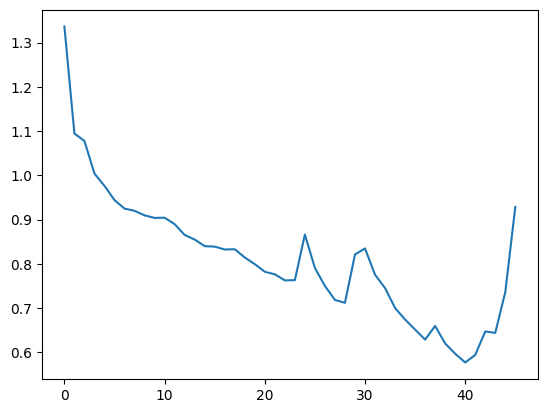

In [ ]:
callbacks = [
    tf.keras.callbacks.ModelCheckpoint(
        filepath='./training_checkpoints/ckpt_{epoch}',
        save_weights_only=True),
    tf.keras.callbacks.EarlyStopping(
        monitor='loss',
        patience=5,
        verbose=1,
        restore_best_weights=True),
]

epochs = 50

history = model.fit(
    train_ds,
    epochs=epochs,
    callbacks=callbacks,
)

plt.plot(history.epoch, history.history['loss'], label='total loss')
plt.show()

In [ ]:
def predict_next_note(
    notes: np.ndarray,
    model: tf.keras.Model,
    temperature: float = 1.0) -> tuple[int, float, float]:
  """Generates a note as a tuple of (pitch, step, duration), using a trained sequence model."""

  assert temperature > 0

  # Add batch dimension
  inputs = tf.expand_dims(notes, 0)

  predictions = model.predict(inputs)
  pitch_logits = predictions['pitch']
  step = predictions['step']
  duration = predictions['duration']

  pitch_logits /= temperature
  pitch = tf.random.categorical(pitch_logits, num_samples=1)
  pitch = tf.squeeze(pitch, axis=-1)
  duration = tf.squeeze(duration, axis=-1)
  step = tf.squeeze(step, axis=-1)

  # `step` and `duration` values should be non-negative
  step = tf.maximum(0, step)
  duration = tf.maximum(0, duration)

  return int(pitch), float(step), float(duration)

# Generating Music

Notes are generated based on an inputted sequence of notes. The first song is taken and 150 notes are generated based on the first 13 notes in the selected song. You can select another song to change the generated music.

In [ ]:
temperature = 2.0
num_predictions = 150

test_data = glob.glob(str('/content/drive/MyDrive/ML Bing Bing/nesmdb_midi/test**/*.mid*'))
sample_file = test_data[0] # Change index here to select different song
raw_notes = midi_to_notes(sample_file)
sample_notes = np.stack([raw_notes[key] for key in key_order], axis=1)

input_notes = (
    sample_notes[:seq_length] / np.array([vocab_size, 1, 1]))

generated_notes = []
prev_start = 0
for _ in range(num_predictions):
  pitch, step, duration = predict_next_note(input_notes, model, temperature)
  start = prev_start + step
  end = start + duration
  input_note = (pitch, step, duration)
  generated_notes.append((*input_note, start, end))
  input_notes = np.delete(input_notes, 0, axis=0)
  input_notes = np.append(input_notes, np.expand_dims(input_note, 0), axis=0)
  prev_start = start

generated_notes = pd.DataFrame(
    generated_notes, columns=(*key_order, 'start', 'end'))

1/1 [==============================] - 0s 21ms/step


In [ ]:
def notes_to_midi(
  notes: pd.DataFrame,
  out_file: str,
  instrument_name: str,
  velocity: int = 100,  # note loudness
) -> pretty_midi.PrettyMIDI:

  pm = pretty_midi.PrettyMIDI()
  instrument = pretty_midi.Instrument(
      program=pretty_midi.instrument_name_to_program(
          instrument_name))

  prev_start = 0
  for i, note in notes.iterrows():
    start = float(prev_start + note['step'])
    end = float(start + note['duration'])
    note = pretty_midi.Note(
        velocity=velocity,
        pitch=int(note['pitch']),
        start=start,
        end=end,
    )
    instrument.notes.append(note)
    prev_start = start

  pm.instruments.append(instrument)
  pm.write(out_file)
  return pm

In [ ]:
pm = pretty_midi.PrettyMIDI(sample_file)
instrument = pm.instruments[0]
instrument_name = pretty_midi.program_to_instrument_name(instrument.program)
out_file = 'output.mid'
out_pm = notes_to_midi(
    generated_notes, out_file=out_file, instrument_name=instrument_name)
FluidSynth().midi_to_audio('output.mid', 'output.wav')
Audio("output.wav")
# display_audio(out_pm)